<a href="https://colab.research.google.com/github/paiml/minimal-python/blob/master/Chapter9_scikit_learn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Chapter 9: Data Science Libraries

**This is a chapter in the book Minimal Python**

* [Buy a copy on LeanPub](https://leanpub.com/minimalpython)
* [Buy a copy from Amazon](https://www.amazon.com/Minimal-Python-efficient-programmer-onemillion2021-ebook/dp/B0855NSRR7)

[*Licensed Under Attribution-NonCommercial-ShareAlike 4.0*](https://creativecommons.org/licenses/by-nc-sa/4.0/)

![Minimal Python Book](https://d2sofvawe08yqg.cloudfront.net/minimalpython/hero?1582640276)

## Learn numpy


References

*   [NVidia ](https://devblogs.nvidia.com/numba-python-cuda-acceleration/)
*   [Numba](http://numba.pydata.org/)



### What is numpy?

* Low level multi-dimensional array library
* A programmers Excel
* The building blocks for many key Python libraries:  
  - Pandas
  - Sklearn
  - Tensorflow


### Hello World Numpy Workflow

In [0]:
import numpy as np

#### Make an array

In [0]:
a = np.arange(6).reshape(2, 3)

#### Print shape

In [3]:
a.shape

(2, 3)

#### Print size

In [4]:
a.size

6

#### Print type

In [5]:
a.dtype.name

'int64'

#### Print contents

In [6]:
a

array([[0, 1, 2],
       [3, 4, 5]])

### Create an Array

#### One Dimensional Array

In [7]:
a = np.array([2,4,6,8])
print(f"Shape {a.shape}")
print(f"Content: {a}")

Shape (4,)
Content: [2 4 6 8]


#### Two Dimensional Array

In [8]:
a = np.array([(2,4,6,8),(20,40,60,80)]) 
print(f"Shape: {a.shape}")
print(f"Content: {a}")

Shape: (2, 4)
Content: [[ 2  4  6  8]
 [20 40 60 80]]


#### Create Sequence of Numbers

In [9]:
a = np.arange(1,20)
print(f"Shape: {a.shape}")
print(f"Content: {a}")


Shape: (19,)
Content: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]


#### Create empty multi-dimensional array

In [10]:
a = np.zeros( (2,3) )
print(f"Shape: {a.shape}")
print(f"Content: {a}")

Shape: (2, 3)
Content: [[0. 0. 0.]
 [0. 0. 0.]]


## Learn sklearn

### Supervized Machine Learning:  Classification Modeling Workflow


#### Key Evaluation Terms



*  [Amazon ML Key Classification Metrics](https://docs.aws.amazon.com/machine-learning/latest/dg/binary-model-insights.html?icmpid=docs_machinelearning_console)
*  [sklearn classification metrics
](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.precision_recall_fscore_support.html)




*   **Precision**:  Measures the fraction of actual positives among those examples that are predicted as positive. The range is 0 to 1. A larger value indicates better predictive accuracy

*  ** Recall**:  Measures the fraction of actual positives that are predicted as positive. The range is 0 to 1. A larger value indicates better predictive accuracy

*   **F1-score**:  Weighted average of recall and precision


* **AUC**:  AUC measures the ability of the model to predict a higher score for positive examples as compared to negative examples

* **False Positive Rat**e:  The false positive rate (FPR) measures the false alarm rate or the fraction of actual negatives that are predicted as positive. The range is 0 to 1. A smaller value indicates better predictive accuracy





#### Digits Dataset

##### sklearn modeling

https://scikit-learn.org/stable/auto_examples/classification/plot_digits_classification.html

Classification report for classifier SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma=0.001, kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False):
              precision    recall  f1-score   support

           0       1.00      0.99      0.99        88
           1       0.99      0.97      0.98        91
           2       0.99      0.99      0.99        86
           3       0.98      0.87      0.92        91
           4       0.99      0.96      0.97        92
           5       0.95      0.97      0.96        91
           6       0.99      0.99      0.99        91
           7       0.96      0.99      0.97        89
           8       0.94      1.00      0.97        88
           9       0.93      0.98      0.95        92

    accuracy                           0.97       899
   macro avg       0.97      0.97      0.97       899
weighted a

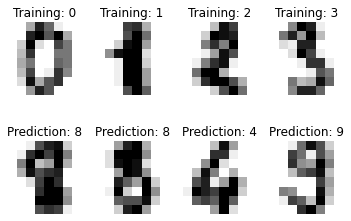

In [11]:
# Standard scientific Python imports
import matplotlib.pyplot as plt

# Import datasets, classifiers and performance metrics
from sklearn import datasets, svm, metrics

# The digits dataset
digits = datasets.load_digits()

# The data that we are interested in is made of 8x8 images of digits, let's
# have a look at the first 4 images, stored in the `images` attribute of the
# dataset.  If we were working from image files, we could load them using
# matplotlib.pyplot.imread.  Note that each image must have the same size. For these
# images, we know which digit they represent: it is given in the 'target' of
# the dataset.
images_and_labels = list(zip(digits.images, digits.target))
for index, (image, label) in enumerate(images_and_labels[:4]):
    plt.subplot(2, 4, index + 1)
    plt.axis('off')
    plt.imshow(image, cmap=plt.cm.gray_r, interpolation='nearest')
    plt.title('Training: %i' % label)

# To apply a classifier on this data, we need to flatten the image, to
# turn the data in a (samples, feature) matrix:
n_samples = len(digits.images)
data = digits.images.reshape((n_samples, -1))

# Create a classifier: a support vector classifier
classifier = svm.SVC(gamma=0.001)

# We learn the digits on the first half of the digits
classifier.fit(data[:n_samples // 2], digits.target[:n_samples // 2])

# Now predict the value of the digit on the second half:
expected = digits.target[n_samples // 2:]
predicted = classifier.predict(data[n_samples // 2:])

print("Classification report for classifier %s:\n%s\n"
      % (classifier, metrics.classification_report(expected, predicted)))
print("Confusion matrix:\n%s" % metrics.confusion_matrix(expected, predicted))

images_and_predictions = list(zip(digits.images[n_samples // 2:], predicted))
for index, (image, prediction) in enumerate(images_and_predictions[:4]):
    plt.subplot(2, 4, index + 5)
    plt.axis('off')
    plt.imshow(image, cmap=plt.cm.gray_r, interpolation='nearest')
    plt.title('Prediction: %i' % prediction)

plt.show()

#### Yellowbrick Confusion Matrix



http://www.scikit-yb.org/en/latest/api/classifier/confusion_matrix.html


In [12]:
from sklearn.datasets import load_digits
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

from yellowbrick.classifier import ConfusionMatrix

/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.metrics.classification module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)


/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


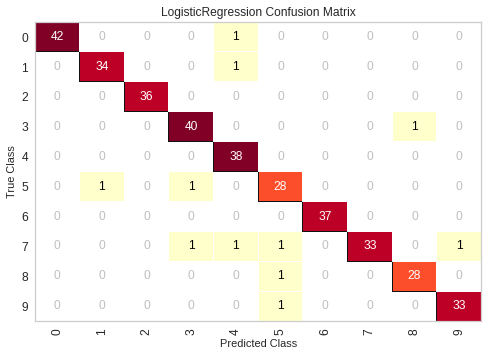

In [13]:

# We'll use the handwritten digits data set from scikit-learn.
# Each feature of this dataset is an 8x8 pixel image of a handwritten number.
# Digits.data converts these 64 pixels into a single array of features
digits = load_digits()
X = digits.data
y = digits.target

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size =0.2, random_state=1)

model = LogisticRegression()

# The ConfusionMatrix visualizer taxes a model
cm = ConfusionMatrix(model, classes=[0,1,2,3,4,5,6,7,8,9])

# Fit fits the passed model. This is unnecessary if you pass the visualizer a pre-fitted model
cm.fit(X_train, y_train)

# To create the ConfusionMatrix, we need some test data. Score runs predict() on the data
# and then creates the confusion_matrix from scikit-learn.
cm.score(X_test, y_test)

# How did we do?
cm.poof()

#### ROCAUC

http://www.scikit-yb.org/en/latest/api/classifier/rocauc.html


/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


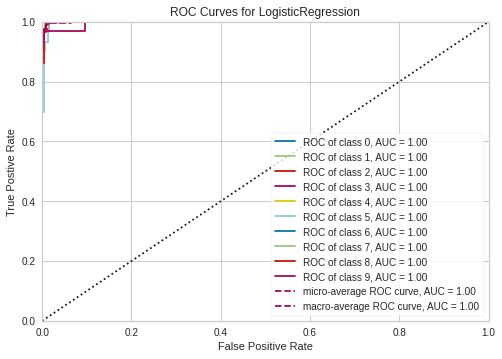

In [14]:
from yellowbrick.classifier import ROCAUC
from sklearn.linear_model import LogisticRegression

model = LogisticRegression()
classes=[0,1,2,3,4,5,6,7,8,9]

# Instantiate the visualizer with the classification model
visualizer = ROCAUC(model, classes=classes)

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
g = visualizer.poof()             # Draw/show/poof the data

### Supervized Machine Learning: Regression Modeling Workflow

#### Ingest

Source:  http://wiki.stat.ucla.edu/socr/index.php/SOCR_Data_MLB_HeightsWeights

In [15]:
import pandas as pd
df = pd.read_csv("https://raw.githubusercontent.com/noahgift/functional_intro_to_python/master/data/mlb_weight_ht.csv")
df.head()


,Name,Team,Position,Height(inches),Weight(pounds),Age
0,Adam_Donachie,BAL,Catcher,74,180.0,22.99
1,Paul_Bako,BAL,Catcher,74,215.0,34.69
2,Ramon_Hernandez,BAL,Catcher,72,210.0,30.78
3,Kevin_Millar,BAL,First_Baseman,72,210.0,35.43
4,Chris_Gomez,BAL,First_Baseman,73,188.0,35.71


Find N/A

In [16]:
df.shape

(1034, 6)

In [17]:
df.isnull().values.any()

True

In [18]:
df = df.dropna()
df.isnull().values.any()

False

In [19]:
df.shape

(1033, 6)

#### Clean

In [20]:
df.rename(index=str, 
             columns={"Height(inches)": "Height", "Weight(pounds)": "Weight"},
             inplace=True)
df.head()


,Name,Team,Position,Height,Weight,Age
0,Adam_Donachie,BAL,Catcher,74,180.0,22.99
1,Paul_Bako,BAL,Catcher,74,215.0,34.69
2,Ramon_Hernandez,BAL,Catcher,72,210.0,30.78
3,Kevin_Millar,BAL,First_Baseman,72,210.0,35.43
4,Chris_Gomez,BAL,First_Baseman,73,188.0,35.71


#### EDA

In [21]:
df.describe()

,Height,Weight,Age
count,1033.000000,1033.000000,1033.000000
mean,73.698935,201.689255,28.737648
std,2.306330,20.991491,4.322298
min,67.000000,150.000000,20.900000
25%,72.000000,187.000000,25.440000
50%,74.000000,200.000000,27.930000
75%,75.000000,215.000000,31.240000
max,83.000000,290.000000,48.520000


#### Model

In [0]:
from sklearn import linear_model
from sklearn.model_selection import train_test_split


#### Create Features


In [23]:
var = df['Weight'].values
var.shape

(1033,)

In [0]:
y = df['Weight'].values #Target
y = y.reshape(-1, 1)
X = df['Height'].values #Feature(s)
X = X.reshape(-1,1)

In [0]:
#X = df[['Height', 'Age']].values

In [26]:
y.shape

(1033, 1)

#### Split data

In [27]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(826, 1) (826, 1)
(207, 1) (207, 1)


#### Fit the model

In [0]:
lm = linear_model.LinearRegression()
model = lm.fit(X_train, y_train)
predictions = lm.predict(X_test)

In [0]:
lm.predict?

Returns Numpy Array

In [30]:
type(predictions)

numpy.ndarray

#### Plot Predictions

Text(0, 0.5, 'Predicted Weight')

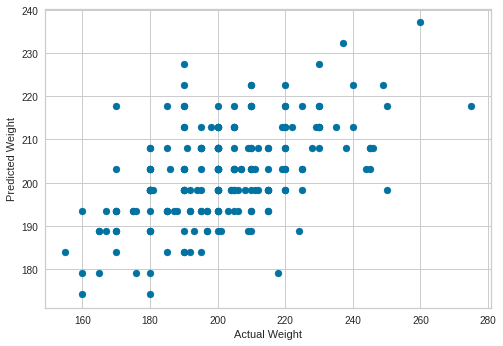

In [31]:
from matplotlib import pyplot as plt
plt.scatter(y_test, predictions)
plt.xlabel("Actual Weight")
plt.ylabel("Predicted Weight")

#### Print Accuracy of Linear Regression Model

In [32]:
model.score(X_test, y_test)

0.2852917409428234

#### Use Cross-Validation

In [0]:
from sklearn.model_selection import cross_val_score, cross_val_predict
from sklearn import metrics

In [34]:
scores = cross_val_score(model, X, y, cv=6)
scores

array([0.29670427, 0.22459508, 0.29543549, 0.30012566, 0.19191046,
       0.34579806])

#### Plot Cross-validation Predictions 

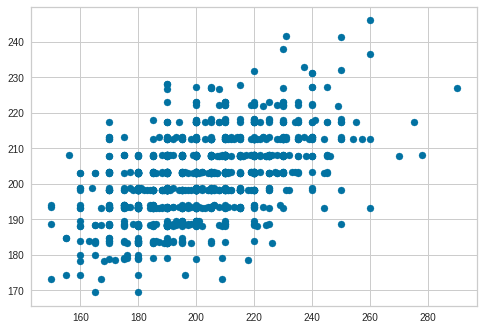

In [35]:
predictions = cross_val_predict(model, X, y, cv=6)
plt.scatter(y, predictions)

In [36]:
accuracy = metrics.r2_score(y, predictions)
accuracy

0.280770222008195

#### Conclusion

* Cross-Validation improved Accuracy
* Adding more data or more features could improve the model
* Major League Baseball may be a strange set to predict Weight
* Bigger Data Set here:  http://socr.ucla.edu/docs/resources/SOCR_Data/SOCR_Data_Dinov_020108_HeightsWeights.html


### Unsupervized Machine Learning:  Clustering

#### Ingest

In [37]:
import pandas as pd

df = pd.read_csv(
    "https://raw.githubusercontent.com/noahgift/food/master/data/features.en.openfoodfacts.org.products.csv")
df.drop(["Unnamed: 0", "exceeded", "g_sum", "energy_100g"], axis=1, inplace=True) #drop two rows we don't need
df = df.drop(df.index[[1,11877]]) #drop outlier
df.rename(index=str, columns={"reconstructed_energy": "energy_100g"}, inplace=True)
df.head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product
0,28.57,64.29,14.29,3.57,0.00000,2267.85,Banana Chips Sweetened (Whole)
2,57.14,17.86,3.57,17.86,1.22428,2835.70,Organic Salted Nut Mix
3,18.75,57.81,15.62,14.06,0.13970,1953.04,Organic Muesli
4,36.67,36.67,3.33,16.67,1.60782,2336.91,Zen Party Mix
5,18.18,60.00,21.82,14.55,0.02286,1976.37,Cinnamon Nut Granola


In [38]:
df.columns

Index(['fat_100g', 'carbohydrates_100g', 'sugars_100g', 'proteins_100g',
       'salt_100g', 'energy_100g', 'product'],
      dtype='object')

#### Create Features to Cluster

In [0]:
df_cluster_features = df.drop("product", axis=1)

#### Scale the data

In [40]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
print(scaler.fit(df_cluster_features))
print(scaler.transform(df_cluster_features))

MinMaxScaler(copy=True, feature_range=(0, 1))
[[2.85700000e-01 6.42900000e-01 1.53063241e-01 6.89388819e-02
  0.00000000e+00 5.06782123e-01]
 [5.71400000e-01 1.78600000e-01 4.71343874e-02 2.06913199e-01
  6.02500000e-04 6.33675978e-01]
 [1.87500000e-01 5.78100000e-01 1.66205534e-01 1.70223038e-01
  6.87500000e-05 4.36433520e-01]
 ...
 [0.00000000e+00 1.33300000e-01 1.43577075e-01 3.44694410e-02
  1.87500000e-05 5.06391061e-02]
 [0.00000000e+00 1.62500000e-01 1.72430830e-01 3.44694410e-02
  1.87500000e-05 6.17318436e-02]
 [0.00000000e+00 0.00000000e+00 1.18577075e-02 3.44694410e-02
  0.00000000e+00 0.00000000e+00]]


#### Add Cluster Labels

In [41]:
from sklearn.cluster import KMeans

k_means = KMeans(n_clusters=3)
kmeans = k_means.fit(scaler.transform(df_cluster_features))
df['cluster'] = kmeans.labels_
df.head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product,cluster
0,28.57,64.29,14.29,3.57,0.00000,2267.85,Banana Chips Sweetened (Whole),0
2,57.14,17.86,3.57,17.86,1.22428,2835.70,Organic Salted Nut Mix,0
3,18.75,57.81,15.62,14.06,0.13970,1953.04,Organic Muesli,0
4,36.67,36.67,3.33,16.67,1.60782,2336.91,Zen Party Mix,0
5,18.18,60.00,21.82,14.55,0.02286,1976.37,Cinnamon Nut Granola,0


## Learn pandas

### Time Series Workflow

#### Ingest Zillow

In [42]:
import pandas as pd
pd.set_option('display.float_format', lambda x: '%.3f' % x)
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
import seaborn as sns
import seaborn as sns; sns.set(color_codes=True)
from sklearn.cluster import KMeans
color = sns.color_palette()
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
%matplotlib inline

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [43]:
df = pd.read_csv("https://raw.githubusercontent.com/noahgift/real_estate_ml/master/data/Zip_Zhvi_SingleFamilyResidence_2018.csv")
df.head()


,RegionID,RegionName,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,1997-01,1997-02,1997-03,1997-04,1997-05,1997-06,1997-07,1997-08,1997-09,1997-10,1997-11,1997-12,1998-01,1998-02,1998-03,1998-04,1998-05,1998-06,1998-07,1998-08,1998-09,1998-10,1998-11,1998-12,...,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,2017-06,2017-07,2017-08,2017-09,2017-10,2017-11,2017-12,2018-01,2018-02,2018-03,2018-04,2018-05,2018-06,2018-07,2018-08,2018-09,2018-10,2018-11,2018-12
0,84654,60657,Chicago,IL,Chicago-Naperville-Elgin,Cook County,1,334200.000,335400.000,336500.000,337600.000,338500.000,339500.000,340400.000,341300.000,342600.000,344400.000,345700.000,346700.000,347800.000,349000.000,350400.000,352000.000,353900.000,356200.000,358800.000,361800.000,365700.000,370200.000,374700.000,378900.000,383500.000,388300.000,393300.000,398500.000,403800.000,409100.000,414600.000,420100.000,426200.000,...,924400,935600,947200,950900,952700,959000,966400,970300,973200,973300,970600,971800,977800,985200,992900,997600,996000,993100,991500,990000,991400,998200,1004000,1006800,1008400,1011300,1015500,1022000,1028900,1034500,1037400,1038700,1041500,1042800,1042900,1044400,1047800,1049700,1048300,1047900
1,91982,77494,Katy,TX,Houston-The Woodlands-Sugar Land,Harris County,2,210400.000,212200.000,212200.000,210700.000,208300.000,205500.000,202500.000,199800.000,198300.000,197300.000,195400.000,193000.000,191800.000,191800.000,193000.000,195200.000,198400.000,202800.000,208000.000,213800.000,220700.000,227500.000,231800.000,233400.000,233900.000,233500.000,233300.000,234300.000,237400.000,242800.000,250200.000,258600.000,268000.000,...,318600,321800,324400,326400,327400,326900,327300,328900,330000,330000,328900,327500,326300,325300,324700,324700,323700,322100,320800,320400,320300,320900,320900,320300,319800,320200,320800,321100,322700,326500,330400,332700,334500,335900,337000,338300,338400,336900,336000,336500
2,84616,60614,Chicago,IL,Chicago-Naperville-Elgin,Cook County,3,498100.000,500900.000,503100.000,504600.000,505500.000,505700.000,505300.000,504200.000,503600.000,503400.000,502200.000,500000.000,497900.000,496300.000,495200.000,494700.000,494900.000,496200.000,498600.000,502000.000,507600.000,514900.000,522200.000,529500.000,537900.000,546900.000,556400.000,566100.000,575600.000,584800.000,593500.000,601600.000,610100.000,...,1199200,1206600,1218000,1226400,1230300,1234700,1240300,1244700,1245800,1245300,1243700,1243400,1245000,1250800,1259300,1266600,1270800,1274500,1278900,1282600,1285800,1288100,1288500,1287500,1289200,1295000,1301100,1304300,1310100,1315300,1317900,1321100,1325300,1323800,1321200,1320700,1319500,1318800,1319700,1323300
3,93144,79936,El Paso,TX,El Paso,El Paso County,4,77300.000,77300.000,77300.000,77300.000,77400.000,77500.000,77600.000,77700.000,77700.000,77800.000,77900.000,77900.000,77800.000,77800.000,77800.000,77800.000,77800.000,77900.000,78100.000,78200.000,78400.000,78600.000,78800.000,79000.000,79100.000,79200.000,79300.000,79300.000,79300.000,79400.000,79500.000,79500.000,79600.000,...,115300,115400,115700,116200,116200,115700,115100,114700,114300,114000,114000,113800,114000,114800,115600,116200,116800,117400,117800,118200,118700,119000,119100,119400,119900,120200,120200,120100,120300,120500,120800,121300,122200,123000,123600,124500,125600,126300,126800,127400
4,91940,77449,Katy,TX,Houston-The Woodlands-Sugar Land,Harris County,5,95400.000,95600.000,95800.000,96100.000,96400.000,96700.000,96800.000,96800.000,96700.000,96600.000,96400.000,96200.000,96100.000,96200.000,96300.000,96600.000,97000.000,97500.000,98000.000,98400.000,98800.000,99200.000,99500.000,99700.000,100000.000,100200.000,100400.000,100700.000,101100.000,101800.000,102900.000,104300.000,106200.000,...,151100,152200,153000,154100,156000,157800,159600,161700,164200,166100,167400,1

#### EDA

In [44]:
df.describe()

,RegionID,RegionName,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,1997-01,1997-02,1997-03,1997-04,1997-05,1997-06,1997-07,1997-08,1997-09,1997-10,1997-11,1997-12,1998-01,1998-02,1998-03,1998-04,1998-05,1998-06,1998-07,1998-08,1998-09,1998-10,1998-11,1998-12,1999-01,1999-02,1999-03,1999-04,...,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,2017-06,2017-07,2017-08,2017-09,2017-10,2017-11,2017-12,2018-01,2018-02,2018-03,2018-04,2018-05,2018-06,2018-07,2018-08,2018-09,2018-10,2018-11,2018-12
count,15508.000,15508.000,15508.000,14338.000,14338.000,14338.000,14338.000,14338.000,14338.000,14338.000,14338.000,14338.000,14338.000,14338.000,14338.000,14338.000,14338.000,14338.000,14339.000,14339.000,14339.000,14339.000,14339.000,14339.000,14341.000,14341.000,14341.000,14341.000,14341.000,14341.000,14341.000,14341.000,14341.000,14341.000,14341.000,14341.000,14341.000,14341.000,14341.000,14341.000,...,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000
mean,80789.618,47683.566,7754.500,115889.866,116007.379,116123.051,116235.493,116358.920,116501.681,116689.315,116907.581,117238.332,117664.193,118078.128,118423.616,118787.948,119168.713,119558.753,119954.634,120370.242,120808.962,121295.209,121815.015,122450.785,123171.271,123872.777,124497.783,125137.836,125776.864,126414.685,127048.762,127686.737,128334.300,129018.053,129726.748,130537.076,131429.726,132301.158,133107.433,133934.391,...,238790.966,239826.470,240812.832,241861.052,242954.830,244030.816,245189.663,246462.368,247669.583,248808.731,250027.367,251311.581,252591.862,253904.372,255310.994,256831.945,258339.206,259759.698,261262.664,262887.316,264400.851,265663.986,266846.337,268082.751,269404.862,270714.302,271990.018,273270.312,275207.828,277550.458,279359.582,280672.685,282148.749,283446.447,284466.282,285500.200,286717.307,288029.320,289187.510,290106.635
std,31521.485,29008.034,4476.918,85115.825,85264.209,85413.118,85566.676,85744.243,85958.867,86230.630,86549.402,86971.783,87457.391,87911.013,88304.191,88713.600,89131.810,89556.450,89987.462,90440.324,90922.257,91451.044,92014.283,92663.554,93352.711,93991.044,94548.296,95109.355,95662.870,96216.335,96773.656,97349.949,97957.319,98618.251,99322.089,100130.055,101005.227,101849.222,102647.404,103497.851,...,325360.309,327274.950,329069.090,330500.853,331825.560,332946.194,333461.297,333920.169,334617.583,334752.123,335125.438,337035.607,339884.665,342345.371,344386.929,345881.384,347061.383,348147.608,349741.444,352145.530,354119.294,354967.988,355388.288,355759.988,356467.611,357858.339,359036.672,360257.074,362182.970,363108.689,361868.364,361360.576,363102.089,365301.815,366277.876,367095.613,366772.521,364624.171,361143.146,359132.687
min,58196.000,1001.000,1.000,11300.000,11500.000,11600.000,11800.000,11800.000,12000.000,12100.000,12200.000,12300.000,12500.000,12600.000,12700.000,12900.000,13000.000,13000.000,13200.000,13300.000,13500.000,13500.000,13600.000,13800.000,14000.000,14100.000,14200.000,14400.000,14500.000,14600.000,14600.000,14800.000,14900.000,14900.000,14900.000,15000.000,15200.000,15200.000,15300.000,15400.000,...,15700.000,15900.000,16000.000,16300.000,16300.000,16300.000,16600.000,16100.000,15900.000,16200.000,16500.000,16900.000,17600.000,17900.000,18000.000,18300.000,17900.000,17700.000,17600.000,17400.000,17300.000,17500.000,18100.000,18600.000,19200.000,19900.000,20400.000,20700.000,20800.000,21500.000,21700.000,21700.000,22100.000,22200.000,22000.000,21800.000,21700.000,21500.000,21600.000,21900.000


#### Clean Up DataFrame
Rename RegionName to ZipCode and Change Zip Code to String 

In [45]:
df.rename(columns={"RegionName":"ZipCode"}, inplace=True)
df["ZipCode"]=df["ZipCode"].map(lambda x: "{:.0f}".format(x))
df["RegionID"]=df["RegionID"].map(lambda x: "{:.0f}".format(x))
df.head()

,RegionID,ZipCode,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,1997-01,1997-02,1997-03,1997-04,1997-05,1997-06,1997-07,1997-08,1997-09,1997-10,1997-11,1997-12,1998-01,1998-02,1998-03,1998-04,1998-05,1998-06,1998-07,1998-08,1998-09,1998-10,1998-11,1998-12,...,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,2017-06,2017-07,2017-08,2017-09,2017-10,2017-11,2017-12,2018-01,2018-02,2018-03,2018-04,2018-05,2018-06,2018-07,2018-08,2018-09,2018-10,2018-11,2018-12
0,84654,60657,Chicago,IL,Chicago-Naperville-Elgin,Cook County,1,334200.000,335400.000,336500.000,337600.000,338500.000,339500.000,340400.000,341300.000,342600.000,344400.000,345700.000,346700.000,347800.000,349000.000,350400.000,352000.000,353900.000,356200.000,358800.000,361800.000,365700.000,370200.000,374700.000,378900.000,383500.000,388300.000,393300.000,398500.000,403800.000,409100.000,414600.000,420100.000,426200.000,...,924400,935600,947200,950900,952700,959000,966400,970300,973200,973300,970600,971800,977800,985200,992900,997600,996000,993100,991500,990000,991400,998200,1004000,1006800,1008400,1011300,1015500,1022000,1028900,1034500,1037400,1038700,1041500,1042800,1042900,1044400,1047800,1049700,1048300,1047900
1,91982,77494,Katy,TX,Houston-The Woodlands-Sugar Land,Harris County,2,210400.000,212200.000,212200.000,210700.000,208300.000,205500.000,202500.000,199800.000,198300.000,197300.000,195400.000,193000.000,191800.000,191800.000,193000.000,195200.000,198400.000,202800.000,208000.000,213800.000,220700.000,227500.000,231800.000,233400.000,233900.000,233500.000,233300.000,234300.000,237400.000,242800.000,250200.000,258600.000,268000.000,...,318600,321800,324400,326400,327400,326900,327300,328900,330000,330000,328900,327500,326300,325300,324700,324700,323700,322100,320800,320400,320300,320900,320900,320300,319800,320200,320800,321100,322700,326500,330400,332700,334500,335900,337000,338300,338400,336900,336000,336500
2,84616,60614,Chicago,IL,Chicago-Naperville-Elgin,Cook County,3,498100.000,500900.000,503100.000,504600.000,505500.000,505700.000,505300.000,504200.000,503600.000,503400.000,502200.000,500000.000,497900.000,496300.000,495200.000,494700.000,494900.000,496200.000,498600.000,502000.000,507600.000,514900.000,522200.000,529500.000,537900.000,546900.000,556400.000,566100.000,575600.000,584800.000,593500.000,601600.000,610100.000,...,1199200,1206600,1218000,1226400,1230300,1234700,1240300,1244700,1245800,1245300,1243700,1243400,1245000,1250800,1259300,1266600,1270800,1274500,1278900,1282600,1285800,1288100,1288500,1287500,1289200,1295000,1301100,1304300,1310100,1315300,1317900,1321100,1325300,1323800,1321200,1320700,1319500,1318800,1319700,1323300
3,93144,79936,El Paso,TX,El Paso,El Paso County,4,77300.000,77300.000,77300.000,77300.000,77400.000,77500.000,77600.000,77700.000,77700.000,77800.000,77900.000,77900.000,77800.000,77800.000,77800.000,77800.000,77800.000,77900.000,78100.000,78200.000,78400.000,78600.000,78800.000,79000.000,79100.000,79200.000,79300.000,79300.000,79300.000,79400.000,79500.000,79500.000,79600.000,...,115300,115400,115700,116200,116200,115700,115100,114700,114300,114000,114000,113800,114000,114800,115600,116200,116800,117400,117800,118200,118700,119000,119100,119400,119900,120200,120200,120100,120300,120500,120800,121300,122200,123000,123600,124500,125600,126300,126800,127400
4,91940,77449,Katy,TX,Houston-The Woodlands-Sugar Land,Harris County,5,95400.000,95600.000,95800.000,96100.000,96400.000,96700.000,96800.000,96800.000,96700.000,96600.000,96400.000,96200.000,96100.000,96200.000,96300.000,96600.000,97000.000,97500.000,98000.000,98400.000,98800.000,99200.000,99500.000,99700.000,100000.000,100200.000,100400.000,100700.000,101100.000,101800.000,102900.000,104300.000,106200.000,...,151100,152200,153000,154100,156000,157800,159600,161700,164200,166100,167400,1681

In [0]:
median_prices = df.median()
#sf_prices = df["City"] == "San Francisco".median()


**Median USA Prices December, 2018**

In [47]:
median_prices.tail()

2018-08   196900.000
2018-09   198100.000
2018-10   199600.000
2018-11   201100.000
2018-12   202150.000
dtype: float64

In [48]:
sf_df = df[df["City"] == "San Francisco"].median()
df_comparison = pd.concat([sf_df,median_prices], axis=1)
df_comparison.columns = ["San Francisco","Median USA"]
df_comparison.tail()


,San Francisco,Median USA
2018-08,1828600.000,196900.000
2018-09,1823200.000,198100.000
2018-10,1823700.000,199600.000
2018-11,1813400.000,201100.000
2018-12,1806000.000,202150.000


#### Transpose


In [49]:
df_transposed = df.transpose()
df_transposed.head(15)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,15468,15469,15470,15471,15472,15473,15474,15475,15476,15477,15478,15479,15480,15481,15482,15483,15484,15485,15486,15487,15488,15489,15490,15491,15492,15493,15494,15495,15496,15497,15498,15499,15500,15501,15502,15503,15504,15505,15506,15507
RegionID,84654,91982,84616,93144,91940,91733,61807,84640,62037,97564,74101,92593,71831,62087,62045,84646,96107,74242,84620,61625,92036,92045,61703,62012,66126,92271,69816,92551,92515,97771,93123,71067,96027,66133,90654,74126,91926,89925,61802,61796,...,62853,94996,98404,99114,58316,70201,98245,62433,91948,93436,93425,66509,81745,66516,58327,70763,93793,94323,62599,59046,81944,99401,59210,96805,81916,96822,95893,62570,59187,79338,94711,62556,99032,62697,99074,58333,59107,75672,93733,95851
ZipCode,60657,77494,60614,79936,77449,77084,10467,60640,11226,94109,37013,78660,32162,11375,11235,60647,90250,37211,60618,10011,77573,77584,10128,11201,20002,78130,28269,78613,78572,94565,79912,30349,90046,20009,75052,37042,77433,73099,10462,10456,...,12942,85611,95728,97149,1255,28757,95497,12156,77457,80510,80481,20618,54524,20625,1270,29915,81430,83821,12480,3215,54865,97733,3812,92322,54832,92341,89413,12444,3765,48728,84781,12429,97028,12720,97102,1338,3293,40404,81225,89155
City,Chicago,Katy,Chicago,El Paso,Katy,Houston,New York,Chicago,New York,San Francisco,Nashville,Pflugerville,The Villages,New York,New York,Chicago,Hawthorne,Nashville,Chicago,New York,League City,Pearland,New York,New York,Washington,New Braunfels,Charlotte,Cedar Park,Mission,Pittsburg,El Paso,Riverdale,Los Angeles,Washington,Grand Prairie,Clarksville,Cypress,Yukon,New York,New York,...,Keene,Elgin,Truckee,Neskowin,Sandisfield,Montreat,Annapolis,Schodack,Matagorda,Allenspark,Ward,Bushwood,Fifield,Cobb Island,Windsor,Bluffton,Placerville,Coolin,Shandaken,Waterville Valley,Port Wing,Crescent,Bartlett,Crestline,Drummond,Green Valley Lake,Glenbrook,Jewett,Haverhill,Curran,Pine Valley,Esopus,Rhododendron,Bethel,Arch Cape,Buckland,Woodstock,Berea,Mount Crested Butte,Mesquite
State,IL,TX,IL,TX,TX,TX,NY,IL,NY,CA,TN,TX,FL,NY,NY,IL,CA,TN,IL,NY,TX,TX,NY,NY,DC,TX,NC,TX,TX,CA,TX,GA,CA,DC,TX,TN,TX,OK,NY,NY,...,NY,AZ,CA,OR,MA,NC,CA,NY,TX,CO,CO,MD,WI,MD,MA,SC,CO,ID,NY,NH,WI,OR,NH,CA,WI,CA,NV,NY,NH,MI,UT,NY,OR,NY,OR,MA,NH,KY,CO,NV
Metro,Chicago-Naperville-Elgin,Houston-The Woodlands-Sugar Land,Chicago-Naperville-Elgin,El Paso,Houston-The Woodlands-Sugar Land,Houston-The Woodlands-Sugar Land,New York-Newark-Jersey City,Chicago-Naperville-Elgin,New York-Newark-Jersey City,San Francisco-Oakland-Hayward,Nashville-Davidson--Murfreesboro--Franklin,Austin-Round Rock,The Villages,New York-Newark-Jersey City,New York-Newark-Jersey City,Chicago-Naperville-Elgin,Los Angeles-Long Beach-Anaheim,Nashville-Davidson--Murfreesboro--Franklin,Chicago-Naperville-Elgin,New York-Newark-Jersey City,Houston-The Woodlands-Sugar Land,Houston-The Woodlands-Sugar Land,New York-Newark-Jersey City,New York-Newark-Jersey City,Washington-Arlington-Alexandria,San Antonio-New Braunfels,Charlotte-Concord-Gastonia,Austin-Round Rock,McAllen-Edinburg-Mission,San Francisco-Oakland-Hayward,El Paso,Atlanta-Sandy Springs-Roswell,Los Angeles-Long Beach-Anaheim,Washington-Arlington-Alexandria,Dallas-Fort Worth-Arlington,Clarksville,Houston-The Woodlands-Sugar Land,Oklahoma City,New York-Newark-Jersey City,New York-Newark-Jersey City,...,NaN,Nogales,Truckee-Grass Valley,NaN,Pittsfield,Asheville,Santa Rosa,Albany-Schenectady-Troy,Bay City,Boulder,Boulder,California-Lexington Park,NaN,Washington-Arlington-Alexandria,Pittsfield,Hilton Head Island-Bluffton-Beaufort,NaN,Sandpoint,Kingston,Claremont-Lebanon,NaN,Klamath Falls,NaN,Riverside-San Bernardino-Ontario,NaN,Riverside-San Bernardino-Ontario,Gardnerville Ranchos,NaN,Claremont-Lebanon,NaN,St. George,Kingston,Portland-Vancouver-Hillsboro,NaN,Astoria,Greenfield Town,Claremont-Lebanon,Richmond-Berea,NaN,Las Vegas-Henderson-Paradise


#### Create Cities DataFrame

In [0]:
cities = df_transposed.iloc[2].values

In [51]:
cities_df = df_transposed.drop(df_transposed.index[:7])
cities_df.columns = cities
cities_df.head()

,Chicago,Katy,Chicago,El Paso,Katy,Houston,New York,Chicago,New York,San Francisco,Nashville,Pflugerville,The Villages,New York,New York,Chicago,Hawthorne,Nashville,Chicago,New York,League City,Pearland,New York,New York,Washington,New Braunfels,Charlotte,Cedar Park,Mission,Pittsburg,El Paso,Riverdale,Los Angeles,Washington,Grand Prairie,Clarksville,Cypress,Yukon,New York,New York,...,Keene,Elgin,Truckee,Neskowin,Sandisfield,Montreat,Annapolis,Schodack,Matagorda,Allenspark,Ward,Bushwood,Fifield,Cobb Island,Windsor,Bluffton,Placerville,Coolin,Shandaken,Waterville Valley,Port Wing,Crescent,Bartlett,Crestline,Drummond,Green Valley Lake,Glenbrook,Jewett,Haverhill,Curran,Pine Valley,Esopus,Rhododendron,Bethel,Arch Cape,Buckland,Woodstock,Berea,Mount Crested Butte,Mesquite
1996-04,334200.000,210400.000,498100.000,77300.000,95400.000,95000.000,152900.000,216500.000,162000.000,766000.000,112400.000,138900.000,101000.000,252400.000,190400.000,122700.000,152500.000,97900.000,142600.000,NaN,141400.000,138500.000,3676700.000,NaN,94300.000,123900.000,126100.000,169600.000,69900.000,139200.000,119700.000,90900.000,340600.000,178800.000,100800.000,72000.000,147300.000,83100.000,154300.000,NaN,...,109100.000,NaN,147700.000,187900.000,124700.000,142800.000,307200.000,94400.000,90700.000,123500.000,126500.000,95100.000,81600.000,115100.000,108600.000,308000.000,242000.000,NaN,70900.000,NaN,NaN,NaN,80900.000,78700.000,93600.000,84200.000,562400.000,104300.000,80800.000,29900.000,135900.000,78300.000,136200.000,62500.000,182600.000,94600.000,92700.000,57100.000,191100.000,176400.000
1996-05,335400.000,212200.000,500900.000,77300.000,95600.000,95200.000,152700.000,216700.000,162300.000,771100.000,112700.000,138600.000,100700.000,251700.000,191000.000,122800.000,152600.000,98000.000,143100.000,NaN,141000.000,138700.000,3704200.000,NaN,94000.000,123900.000,126600.000,169000.000,69700.000,138300.000,119700.000,91100.000,341700.000,179200.000,100900.000,73100.000,147600.000,83800.000,154300.000,NaN,...,107600.000,NaN,147800.000,188900.000,125100.000,143300.000,306300.000,94600.000,91000.000,123200.000,125800.000,96000.000,81600.000,114200.000,107400.000,310900.000,243700.000,NaN,70400.000,NaN,NaN,NaN,80800.000,78500.000,93200.000,84200.000,562800.000,104300.000,80100.000,30300.000,136300.000,78300.000,136600.000,62600.000,183700.000,94300.000,92500.000,57300.000,192400.000,176300.000
1996-06,336500.000,212200.000,503100.000,77300.000,95800.000,95400.000,152600.000,216900.000,162600.000,776500.000,113000.000,138400.000,100400.000,251400.000,191500.000,122800.000,152600.000,98200.000,143400.000,NaN,140600.000,139200.000,3729600.000,NaN,93700.000,123800.000,127100.000,168600.000,69600.000,137500.000,119800.000,91200.000,343000.000,179600.000,101000.000,74100.000,148100.000,84000.000,154400.000,NaN,...,106300.000,NaN,148100.000,189700.000,125500.000,143600.000,305500.000,94800.000,91200.000,122900.000,125100.000,96900.000,81500.000,113300.000,106200.000,313800.000,245300.000,NaN,70000.000,NaN,NaN,NaN,80800.000,78300.000,92800.000,84300.000,562700.000,104300.000,79400.000,30700.000,136600.000,78200.000,136800.000,62700.000,184800.000,94000.000,92400.000,57500.000,193700.000,176100.000
1996-07,337600.000,210700.000,504600.000,77300.000,96100.000,95700.000,152400.000,217000.000,163000.000,781900.000,113400.000,138500.000,100100.000,251200.000,192000.000,122700.000,152600.000,98400.000,143300.000,NaN,140500.000,139900.000,3754600.000,NaN,93600.000,123800.000,127600.000,168500.000,69300.000,136600.000,119900.000,91300.000,344400.000,180000.000,101000.000,75000.000,148600.000,83900.000,154400.000,NaN,...,104900.000,NaN,148400.000,190400.000,126000.000,143700.000,304900.000,94900.000,91500.000,122600.000,124400.000,97700.000,81400.000,112100.000,105000.000,316900.000,246900.000,NaN,69700.000,NaN,NaN,NaN,80800.000,78000.000,92300.000,84300.000,562400.000,104300.000,78600.000,31100.000,136900.000,78200.000,136800.000,62700.000,185800.000,93700.000,92200.000,57700.

#### Create time series

In [0]:
from pandas.plotting import autocorrelation_plot


In [0]:
sf_values = cities_df.iloc[:, 9].values
index = pd.DatetimeIndex(cities_df.index.values)
sf_data = pd.Series(sf_values, index=index)


#### autocorrelation plot

Reference:  https://pandas.pydata.org/pandas-docs/stable/user_guide/visualization.html#visualization-autocorrelation

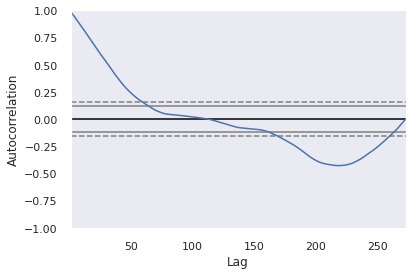

In [54]:
autocorrelation_plot(sf_data)

In [55]:
sf_data.tail()

2018-08-01    3993000
2018-09-01    3999000
2018-10-01    4014600
2018-11-01    4009500
2018-12-01    4016600
dtype: object

#### Simple Plot

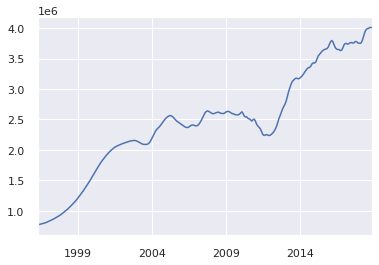

In [56]:
sf_data.plot()

### DataFrame Workflow

#### Ingest

In [0]:
import pandas as pd

In [58]:
df = pd.read_csv(
    "https://raw.githubusercontent.com/noahgift/food/master/data/features.en.openfoodfacts.org.products.csv")
df.drop(["Unnamed: 0", "exceeded", "g_sum", "energy_100g"], axis=1, inplace=True) #drop two rows we don't need
df = df.drop(df.index[[1,11877]]) #drop outlier
df.rename(index=str, columns={"reconstructed_energy": "energy_100g"}, inplace=True)
df.head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product
0,28.570,64.290,14.290,3.570,0.000,2267.850,Banana Chips Sweetened (Whole)
2,57.140,17.860,3.570,17.860,1.224,2835.700,Organic Salted Nut Mix
3,18.750,57.810,15.620,14.060,0.140,1953.040,Organic Muesli
4,36.670,36.670,3.330,16.670,1.608,2336.910,Zen Party Mix
5,18.180,60.000,21.820,14.550,0.023,1976.370,Cinnamon Nut Granola


#### EDA

In [59]:
df.columns

Index(['fat_100g', 'carbohydrates_100g', 'sugars_100g', 'proteins_100g',
       'salt_100g', 'energy_100g', 'product'],
      dtype='object')

#### Rows and Attributes

In [60]:
df.shape

(45026, 7)

#### First Five Columns

In [61]:
df.head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product
0,28.570,64.290,14.290,3.570,0.000,2267.850,Banana Chips Sweetened (Whole)
2,57.140,17.860,3.570,17.860,1.224,2835.700,Organic Salted Nut Mix
3,18.750,57.810,15.620,14.060,0.140,1953.040,Organic Muesli
4,36.670,36.670,3.330,16.670,1.608,2336.910,Zen Party Mix
5,18.180,60.000,21.820,14.550,0.023,1976.370,Cinnamon Nut Granola


#### Descriptive Statistics

In [62]:
df.describe()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g
count,45026.000,45026.000,45026.000,45026.000,45026.000,45026.000
mean,10.766,34.054,16.005,6.617,1.470,1111.286
std,14.930,29.557,21.496,7.926,12.795,791.609
min,0.000,0.000,-1.200,-3.570,0.000,0.000
25%,0.000,7.440,1.570,0.000,0.064,334.520
50%,3.170,22.390,5.880,4.000,0.635,1121.540
75%,17.860,61.540,23.080,9.520,1.440,1678.460
max,100.000,100.000,100.000,100.000,2032.000,4475.000


#### Correlations

In [63]:
df.corr()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g
fat_100g,1.000,-0.051,-0.068,0.383,-0.003,0.768
carbohydrates_100g,-0.051,1.000,0.669,-0.097,-0.011,0.580
sugars_100g,-0.068,0.669,1.000,-0.277,-0.030,0.327
proteins_100g,0.383,-0.097,-0.277,1.000,0.016,0.391
salt_100g,-0.003,-0.011,-0.030,0.016,1.000,-0.007
energy_100g,0.768,0.580,0.327,0.391,-0.007,1.000


#### Filtering by Quantiles

##### Find fatty foods in the 98th percentile

In [64]:
high_fat_df = df[df.fat_100g > df.fat_100g.quantile(.98)]
high_fat_text = high_fat_df['product'].values
len(high_fat_text)

878

In [65]:
high_fat_text[0]

'Organic Salted Nut Mix'

##### Find protein foods in the 98th percentile

In [66]:
high_protein_df = df[df.proteins_100g > df.proteins_100g.quantile(.98)]
high_protein_text = high_protein_df['product'].values
len(high_protein_text)

896

In [67]:
high_protein_text[0]

'Organic Yellow Split Peas'

## Learn tensorflow

## Use seaborn for 2D plots

### Faceted Distribution Plots

Generate distributions based on energy type

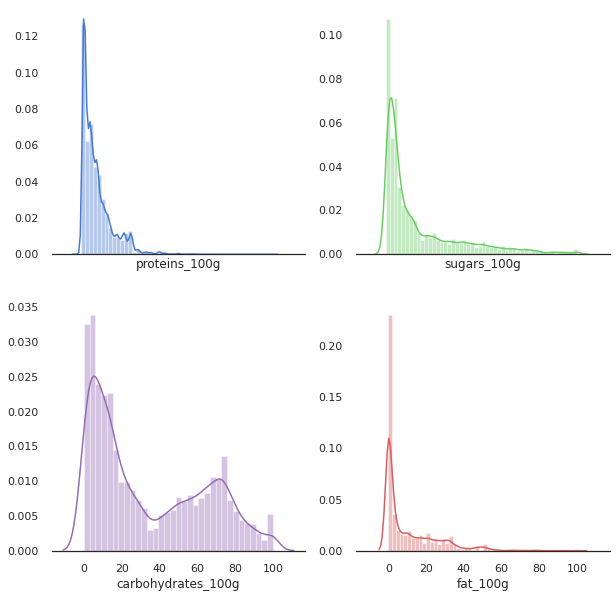

In [68]:
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import matplotlib.cbook
warnings.filterwarnings("ignore",category=matplotlib.cbook.mplDeprecation)
sns.set(style="white", palette="muted", color_codes=True)


# Set up the matplotlib figure
f, axes = plt.subplots(2, 2, figsize=(10, 10), sharex=True)
sns.despine(left=True)

# Plot each distribution on the 4 points
sns.distplot(df.proteins_100g, color="b", ax=axes[0, 0])
sns.distplot(df.sugars_100g, color="g", ax=axes[0, 1])
sns.distplot(df.fat_100g, color="r", ax=axes[1, 1])
sns.distplot(df.carbohydrates_100g, color="m", ax=axes[1, 0])

### Pairplot

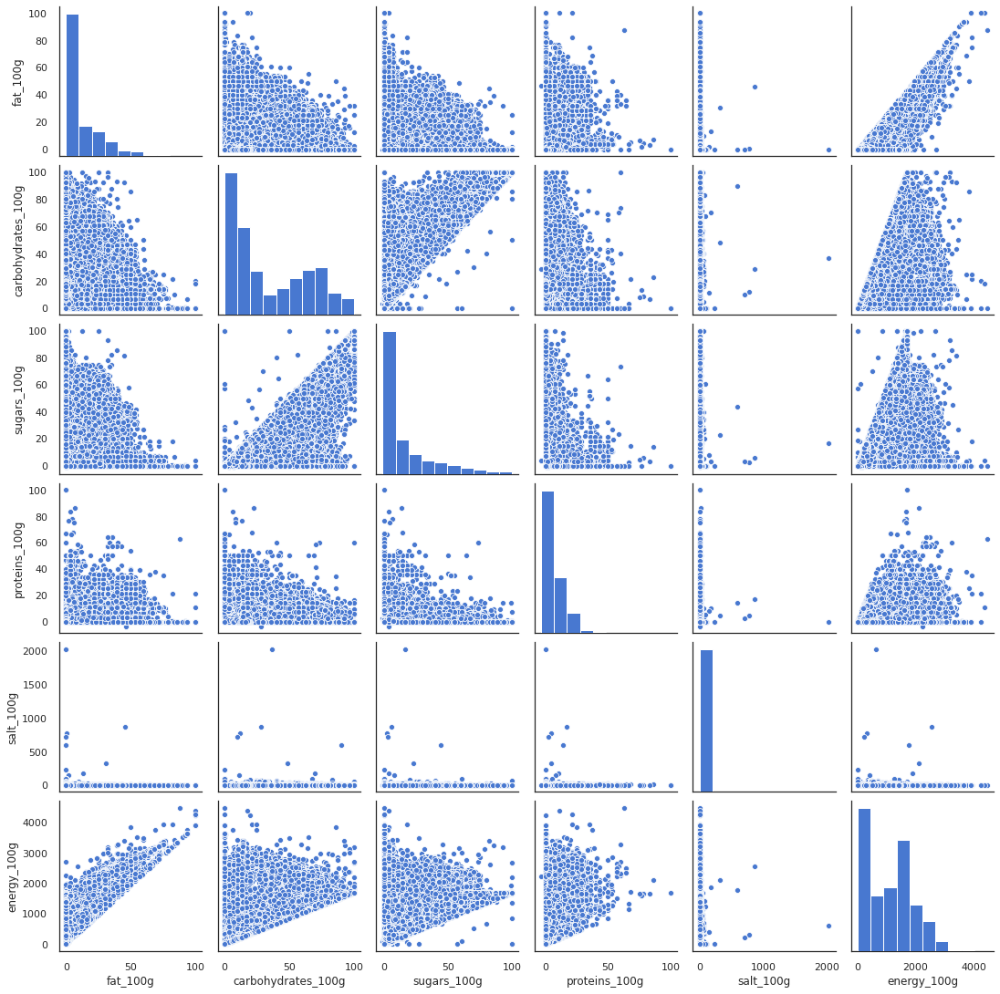

In [69]:
import seaborn as sns
sns.pairplot(df)

### lmplot


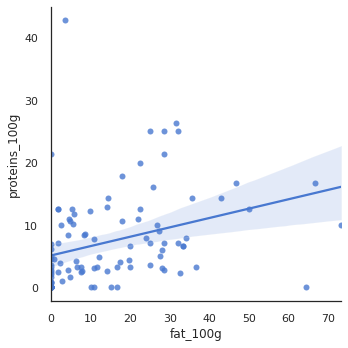

In [70]:
import seaborn as sns
sns.lmplot(x="fat_100g", y="proteins_100g",  data=df.sample(100))

### heatmap

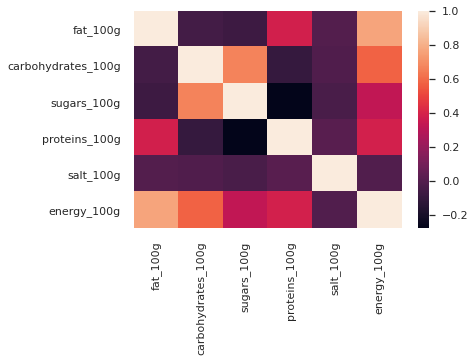

In [71]:
sns.heatmap(df.corr())

## Use Plotly for interactive plots

### Unsupervized Machine Learning:  Clustering

#### Ingest

In [72]:
import pandas as pd

df = pd.read_csv(
    "https://raw.githubusercontent.com/noahgift/food/master/data/features.en.openfoodfacts.org.products.csv")
df.drop(["Unnamed: 0", "exceeded", "g_sum", "energy_100g"], axis=1, inplace=True) #drop two rows we don't need
df = df.drop(df.index[[1,11877]]) #drop outlier
df.rename(index=str, columns={"reconstructed_energy": "energy_100g"}, inplace=True)
df.head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product
0,28.570,64.290,14.290,3.570,0.000,2267.850,Banana Chips Sweetened (Whole)
2,57.140,17.860,3.570,17.860,1.224,2835.700,Organic Salted Nut Mix
3,18.750,57.810,15.620,14.060,0.140,1953.040,Organic Muesli
4,36.670,36.670,3.330,16.670,1.608,2336.910,Zen Party Mix
5,18.180,60.000,21.820,14.550,0.023,1976.370,Cinnamon Nut Granola


In [73]:
df.columns

Index(['fat_100g', 'carbohydrates_100g', 'sugars_100g', 'proteins_100g',
       'salt_100g', 'energy_100g', 'product'],
      dtype='object')

#### Create Features to Cluster

In [0]:
df_cluster_features = df.drop("product", axis=1)

#### Scale the data

In [75]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
print(scaler.fit(df_cluster_features))
print(scaler.transform(df_cluster_features))

MinMaxScaler(copy=True, feature_range=(0, 1))
[[2.85700000e-01 6.42900000e-01 1.53063241e-01 6.89388819e-02
  0.00000000e+00 5.06782123e-01]
 [5.71400000e-01 1.78600000e-01 4.71343874e-02 2.06913199e-01
  6.02500000e-04 6.33675978e-01]
 [1.87500000e-01 5.78100000e-01 1.66205534e-01 1.70223038e-01
  6.87500000e-05 4.36433520e-01]
 ...
 [0.00000000e+00 1.33300000e-01 1.43577075e-01 3.44694410e-02
  1.87500000e-05 5.06391061e-02]
 [0.00000000e+00 1.62500000e-01 1.72430830e-01 3.44694410e-02
  1.87500000e-05 6.17318436e-02]
 [0.00000000e+00 0.00000000e+00 1.18577075e-02 3.44694410e-02
  0.00000000e+00 0.00000000e+00]]


#### Add Cluster Labels

In [76]:
from sklearn.cluster import KMeans

k_means = KMeans(n_clusters=3)
kmeans = k_means.fit(scaler.transform(df_cluster_features))
df['cluster'] = kmeans.labels_
df.head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product,cluster
0,28.570,64.290,14.290,3.570,0.000,2267.850,Banana Chips Sweetened (Whole),1
2,57.140,17.860,3.570,17.860,1.224,2835.700,Organic Salted Nut Mix,1
3,18.750,57.810,15.620,14.060,0.140,1953.040,Organic Muesli,1
4,36.670,36.670,3.330,16.670,1.608,2336.910,Zen Party Mix,1
5,18.180,60.000,21.820,14.550,0.023,1976.370,Cinnamon Nut Granola,1


### 2D Plots

In [0]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
  '''))
  init_notebook_mode(connected=False)

In [78]:
from plotly.offline import init_notebook_mode
enable_plotly_in_cell()
init_notebook_mode(connected=False)

import cufflinks as cf
cf.go_offline()
df.sample(1000).iplot(kind='bubble', 
                      size='energy_100g', 
                      mode='markers', 
                      x='fat_100g', 
                      y='proteins_100g',
                      xTitle='Fat', 
                      yTitle='Protein',
                      text="product")

### 3D ClusterPlot

#### Protein-Fat-Carb 3D Plot

In [79]:
import plotly.offline as py
import plotly.graph_objs as go

from plotly.offline import init_notebook_mode
enable_plotly_in_cell()


trace1 = go.Scatter3d(
    x=df["fat_100g"],
    y=df["carbohydrates_100g"],
    z=df["proteins_100g"],
    mode='markers',
    text=df["product"],
    marker=dict(
        size=12,
        color=df["cluster"],                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )
)
#print(trace1)
data = [trace1]
layout = go.Layout(
    showlegend=False,
    title="Protein-Fat-Carb:  Food Energy Types",
    scene = dict(
        xaxis = dict(title='X: Fat Content-100g'),
        yaxis = dict(title="Y:  Carbohydrate Content-100g"),
        zaxis = dict(title="Z:  Protein Content-100g"),
    ),
    width=1000,
    height=900,
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='3d-scatter-colorscale')

#### Sugar-Salt-Carb-3D Plot

In [80]:
import plotly.offline as py
import plotly.graph_objs as go

from plotly.offline import init_notebook_mode
enable_plotly_in_cell()


trace1 = go.Scatter3d(
    x=df["sugars_100g"],
    y=df["carbohydrates_100g"],
    z=df["salt_100g"],
    mode='markers',
    text=df["product"],
    marker=dict(
        size=12,
        color=df["cluster"],                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )
)
#print(trace1)
data = [trace1]
layout = go.Layout(
    showlegend=False,
    title="Sugar, Carb, Salt:  Food Energy Types",
    scene = dict(
        xaxis = dict(title='X: Sugar Content-100g'),
        yaxis = dict(title="Y: Carbohydrate Content-100g"),
        zaxis = dict(title="Z: Salt Content-100g"),
    ),
    width=1000,
    height=900,
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='3d-scatter-colorscale')

## Specialized Visualization Libraries

### Yellowbrick


#### Visualize Regression Lasso (Regression) Model Accuracy with Yellowbrick

Note, uses Lasso Regression

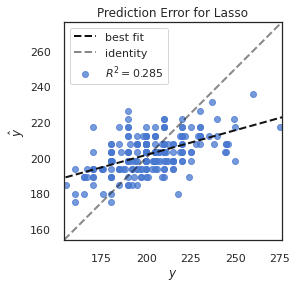

In [81]:
from yellowbrick.regressor import PredictionError
from sklearn.linear_model import Lasso

lasso = Lasso()
visualizer = PredictionError(lasso)
visualizer.fit(X_train, y_train) # Fit the training data to the visualizer
visualizer.score(X_test, y_test) # Evaluate the model on the test data
g = visualizer.poof()            # Draw/show/poof the data

#### Visualize cross-validated scores for Linear regression model

See this:  http://www.scikit-yb.org/en/latest/api/model_selection/cross_validation.html

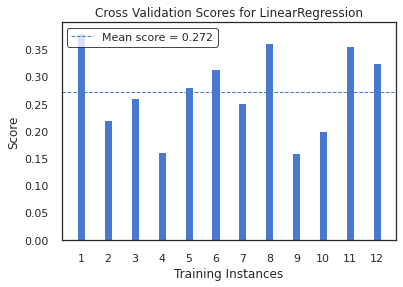

In [82]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import KFold
from yellowbrick.model_selection import CVScores

# Create a new figure and axes
_, ax = plt.subplots()
cv = KFold(12)

oz = CVScores(
    linear_model.LinearRegression(), ax=ax, cv=cv, scoring='r2'
)

oz.fit(X, y)
oz.poof()

### Word Cloud

In [0]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

#### High protein foods

Find protein foods in the 98th percentile

In [84]:
high_protein_df = df[df.proteins_100g > df.proteins_100g.quantile(.98)]
high_protein_text = high_protein_df['product'].values
len(high_protein_text)

896

Word Cloud High Protein

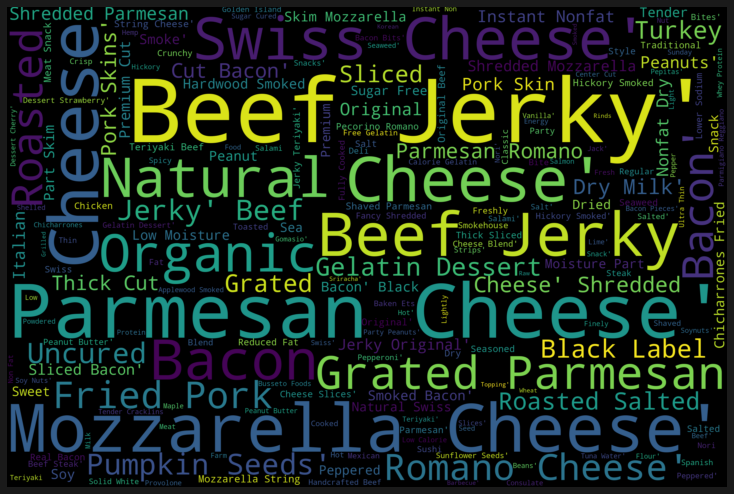

In [85]:
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(high_protein_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

#### High fat foods

Find fatty foods in the 98th percentile

In [86]:
high_fat_df = df[df.fat_100g > df.fat_100g.quantile(.98)]
high_fat_text = high_fat_df['product'].values
len(high_fat_text)

878

Word Cloud High Fat

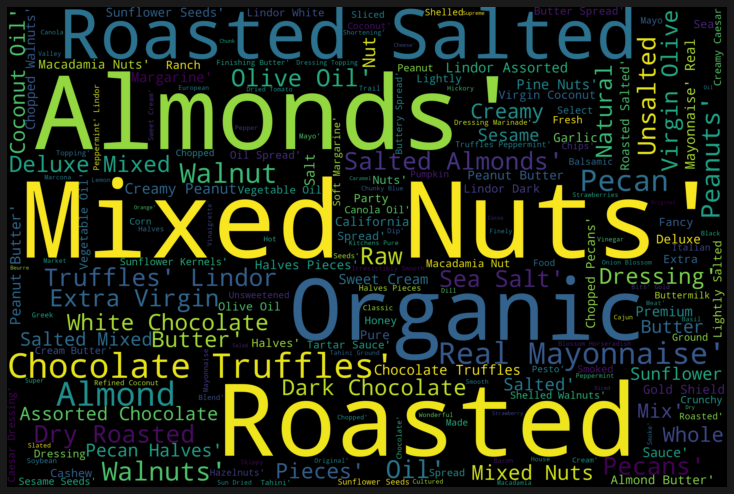

In [87]:
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(high_fat_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

#### High sugar foods

Find sugary foods in the 98th percentile

In [88]:
high_sugar_df = df[df.sugars_100g > df.sugars_100g.quantile(.98)]
high_sugar_text = high_sugar_df['product'].values
len(high_sugar_text)

893

Word Cloud High Sugar

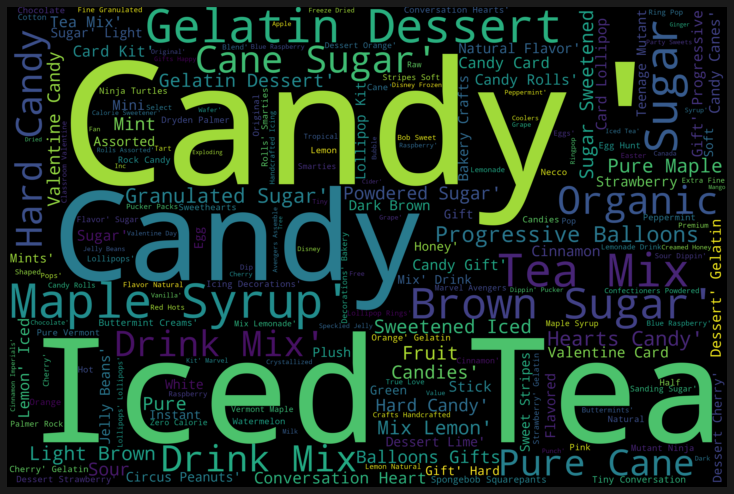

In [89]:
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(high_sugar_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

## Learn Natural Language Processing Libraries

### NLTK Stopword Processing


#### Setup Stop Words

In [90]:
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
stop = stopwords.words('english')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


#### Preprocess Text

In [0]:
dataset = df['product'].fillna("").values
raw_text_data = [d.split() for d in dataset]

#### Remove stop words


In [0]:
text_data = [item for item in raw_text_data if item not in stop]

### Gensim Topic Modeling

In [0]:
from gensim import corpora
dictionary = corpora.Dictionary(text_data)
corpus = [dictionary.doc2bow(text) for text in text_data]

In [0]:
import gensim
NUM_TOPICS = 5
ldamodel = gensim.models.ldamodel.LdaModel(
    corpus, num_topics = NUM_TOPICS, id2word=dictionary, passes=15)

topics = ldamodel.print_topics(num_words=4)
for topic in topics:
    print(topic)